# Characterizing Clinical Text Using Clinical LLM Latent Representations
## Results Presentation

Summer 2023

SULI Internship: Ifrah Khurram

LBNL Mentors: Rafael Zamora-Resendiz, Silvia Crivelli Ph.D.

### Overview
This notebook serves as a tool to interact with large language model (LLM) embeddings of MIMIC-IV discharge reports.
In this exploratory work, we analyze 12-different LLM embeddings (of varied model size, input length, and
pretraining strategies) for 331,793 unique discharge reports existing in MIMIC-IV.
We have not yet explored the 2,299,451 unique radiology reports also found in MIMIC-IV.
This notebook implements some basic functionality to review the project results precomputed on NERSC's Perlmutter
and load renderings of the LLM latent spaces colored along common medical variables and 
ICD-coded Dx phenotypes.

### Purpose of Research
With increased interest in employing LLMs for clinical NLP and healthcare A.I., there is an increased 
need for tools to assess how LLMs organize medical information. In particular, the team is interested in how 
document respresentions by LLM correlate with structured medical variables used in clinical risk modeling. 
Current state-of-the-art (SOTA) models continue to show improved performance on broad NLP tasks by scaling 
LLM development to larger model sizes and pretraining corpuses. Even so, clinical LLM development lags behind 
results shown for LLMs trained on general internet corpuses such as GPT-3, GPT-4, BLOOM, etc.
This work takes a look at contemporary clinical LLMs and focuses on developing methods to assess the
clustering quality of LLM latent space w.r.t patient age, sex, race, life expectancy, fraility and
clinical phenotypes. Additonally, this suite of tools can be iteratively expanded to new medical variables
and LLMs.

### Precomputing LLM Embeddings, KMeans Clusters, & UMAP 2D

LLM inference was benchmarked and scaled on NERSC's Perlmutter. The table of benchmarking results can be found 
[here](https://github.com/CrivelliLab/OSA_Phenotyping_LLMs/tree/main#project-api). Each LLM was tested to 
see how many corpus documents can be embedded on the NVidia A100 GPUs hosted on Perlmutter. After the 
max throughput was found, the corpus was partitioned among `G` A100s where each worker `g` traverses 
a partition of the corpus in batches of max size `bs`. After the full corpus has been embedded at the document level, 
a grid search over KMeans clusterings and UMAP projections were computed on each embedding model.
The embeddings, clusters, and umap (x,y) coordinates can be found under `/global/cfs/cdirs/m1532/Projects_MVP/_models/embeds/LLMs/`.

## Results: Shannon Entropy Over LLM Embedding Clusters

The following displays the clustering entropy for each embedding cluster model. Shannon Entropy was used to 
measure the purity of K-means clusters w.r.t to various medical variables and phenotypes. The table colors
the entropies where the low entropy (high purity) is green and high entropy (low purity) in red. The best model
per each variable is colored teal. The worst model per each variable is colored magenta.

In [1]:
#- Imports
import os
import numpy as np
import pandas as pd
from io import BytesIO
import PIL
from IPython.display import display, Image

#--
def display_image(path):
    im = PIL.Image.open(path)
    bio = BytesIO()
    im.save(bio, format='png')
    display(Image(bio.getvalue(), format='png'))

#--
def display_image_row(paths, width=400, height=400, offset=0):
    imgs = [PIL.Image.open(path).resize([width, height]) for path in paths]
    dst = PIL.Image.new('RGB', ((len(imgs)*width), height))
    for i, img in enumerate(imgs):
        dst.paste(img, (i*width, offset*height))
    bio = BytesIO()
    dst.save(bio, format='png')
    display(Image(bio.getvalue(), format='png'))

#--
def display_image_col(paths, width=400, height=400, offset=0):
    imgs = [PIL.Image.open(path).resize([width, height]) for path in paths]
    dst = PIL.Image.new('RGB', (width, len(imgs)*height))
    for i, img in enumerate(imgs):
        dst.paste(img, (offset*width, i*height))
    bio = BytesIO()
    dst.save(bio, format='png')
    display(Image(bio.getvalue(), format='png'))

#-
ENTROPYPATH = "/pscratch/sd/r/rzamora/OSA_Phenotyping_LLMs/output/entropy/"
UMAPPATH = ENTROPYPATH + "{}.discharge.layer.{}.nclusters.{}.nn.256.min.0.001.var.{}.png"
cols = ["model", "layer", "nb_clusters", "entropy"]
entropy = pd.read_csv("{}entropy.csv".format(ENTROPYPATH))
results = None
for var in entropy.variable.unique():
    if results is None:
        results = entropy[entropy.variable==var][cols].rename(columns={"entropy":"entropy_{}".format(var)})
    else:
        results = results.merge(entropy[entropy.variable==var][cols].rename(columns={"entropy":"entropy_{}".format(var)}))
results["overall"] = results[results.columns[3:]].sum(axis=1)
results = results.sort_values("overall").reset_index(drop=True).reset_index().rename(columns={"index":"overall_rank"}).drop(columns=["overall"])
df = results[results.columns]
results = results.style.background_gradient(subset=results.columns[4:], cmap='RdYlGn_r')
results = results.highlight_min(subset=results.columns[4:], color="teal")
results = results.highlight_max(subset=results.columns[4:], color="magenta")
pd.set_option('display.max_rows', 500)
results

,overall_rank,model,layer,nb_clusters,entropy_sex,entropy_race,entropy_age,entropy_dxslog2,entropy_dead,entropy_minstoDeathlog10,entropy_osa.afib,entropy_osa.cad,entropy_osa.hf,entropy_osa.htn,entropy_osa.strokeb,entropy_osa.stroken,entropy_osa.t2dm
0,0,Gatortron_base,0,256,0.591485,0.807560,2.589954,2.130998,0.492092,0.820916,0.779102,0.754038,0.762043,0.493958,0.711339,0.624382,0.767820
1,1,Gatortron_s,0,256,0.540748,0.815286,2.589887,2.130971,0.510295,0.820921,0.794711,0.764236,0.774616,0.494021,0.736561,0.648613,0.772345
2,2,BioGPT_large,0,256,0.643012,0.807871,2.589731,2.131009,0.500858,0.820895,0.786370,0.760559,0.761446,0.491702,0.712502,0.628751,0.770189
3,3,Gatortron_medium,0,256,0.636637,0.809103,2.589754,2.131034,0.495234,0.821003,0.783808,0.761356,0.763871,0.494172,0.725949,0.636939,0.769422
4,4,BioGPT_base,0,256,0.646135,0.809853,2.589630,2.130910,0.507865,0.820781,0.787488,0.761858,0.764580,0.492331,0.718786,0.634435,0.771371
5,5,Gatortron_base,0,128,0.608862,0.812907,2.591977,2.132093,0.504441,0.821880,0.795993,0.768492,0.781043,0.500045,0.728378,0.640471,0.778232
6,6,Gatortron_medium,0,128,0.647563,0.814923,2.591970,2.132085,0.503313,0.821819,0.793836,0.769022,0.781157,0.497537,0.738278,0.651236,0.775004
7,7,Gatortron_s,0,128,0.557460,0.818990,2.591939,2.132069,0.522572,0.821896,0.807634,0.773808,0.793733,0.498867,0.753688,0.664741,0.781109
8,8,BioGPT_large,0,128,0.652320,0.811880,2.591792,2.132106,0.512884,0.821816,0.796886,0.769715,0.781978,0.495026,0.731086,0.648413,0.776590
9,9,BioGPT_base,0,128,0.653154,0.812840,2.591862,2.132093,0.516765,0.821865,0.799626,0.769920,0.780996,0.496929,0.732236,0.647713,0.778458


### Render UMAP Plots Per Model

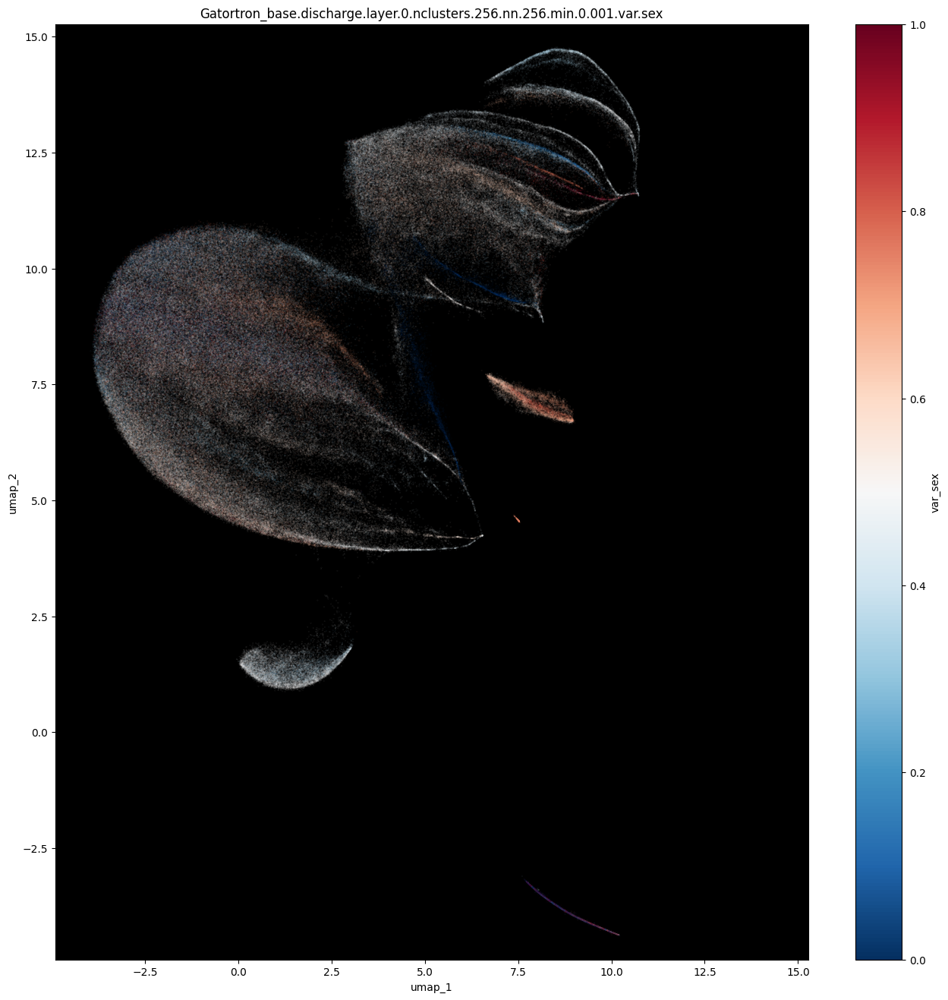

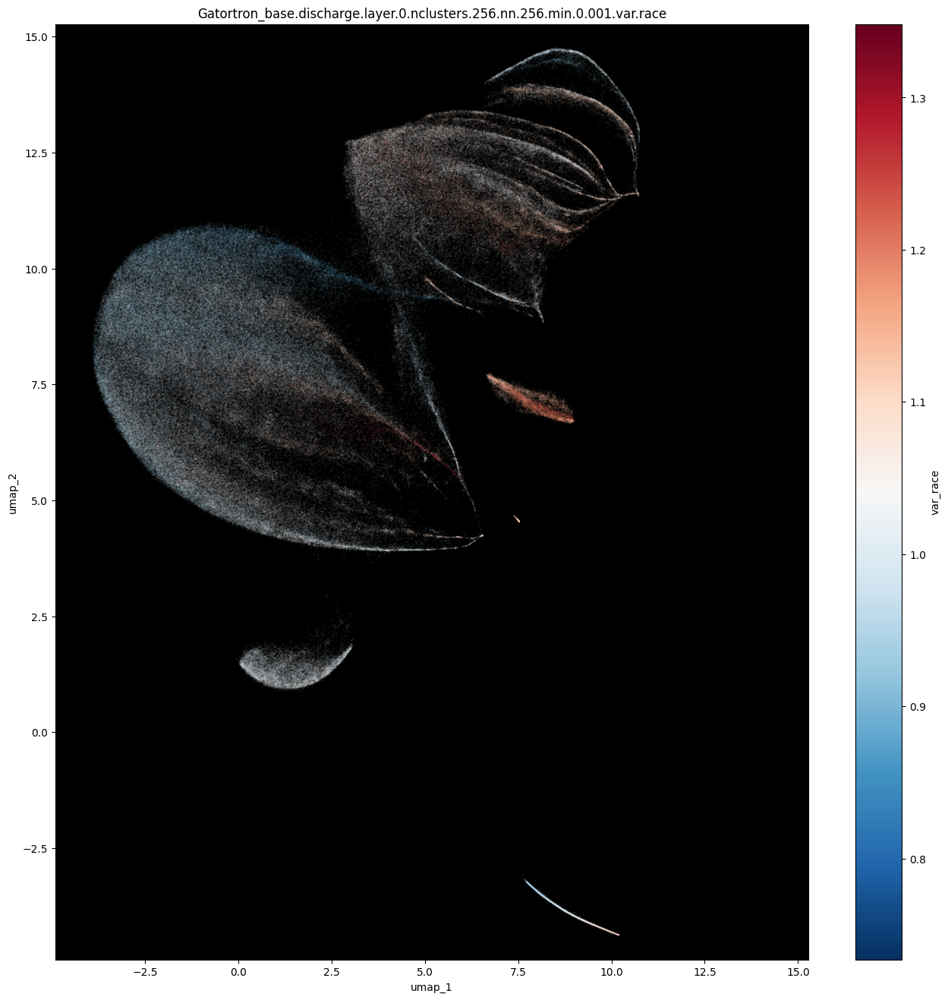

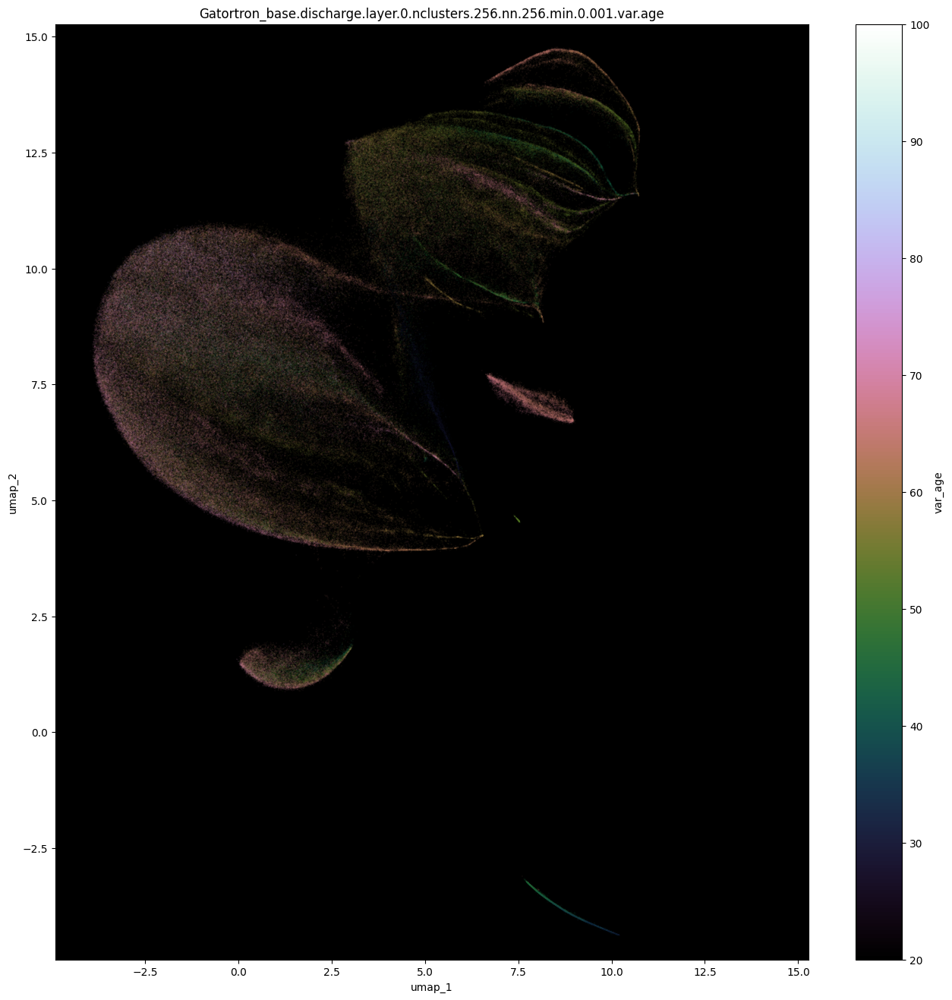

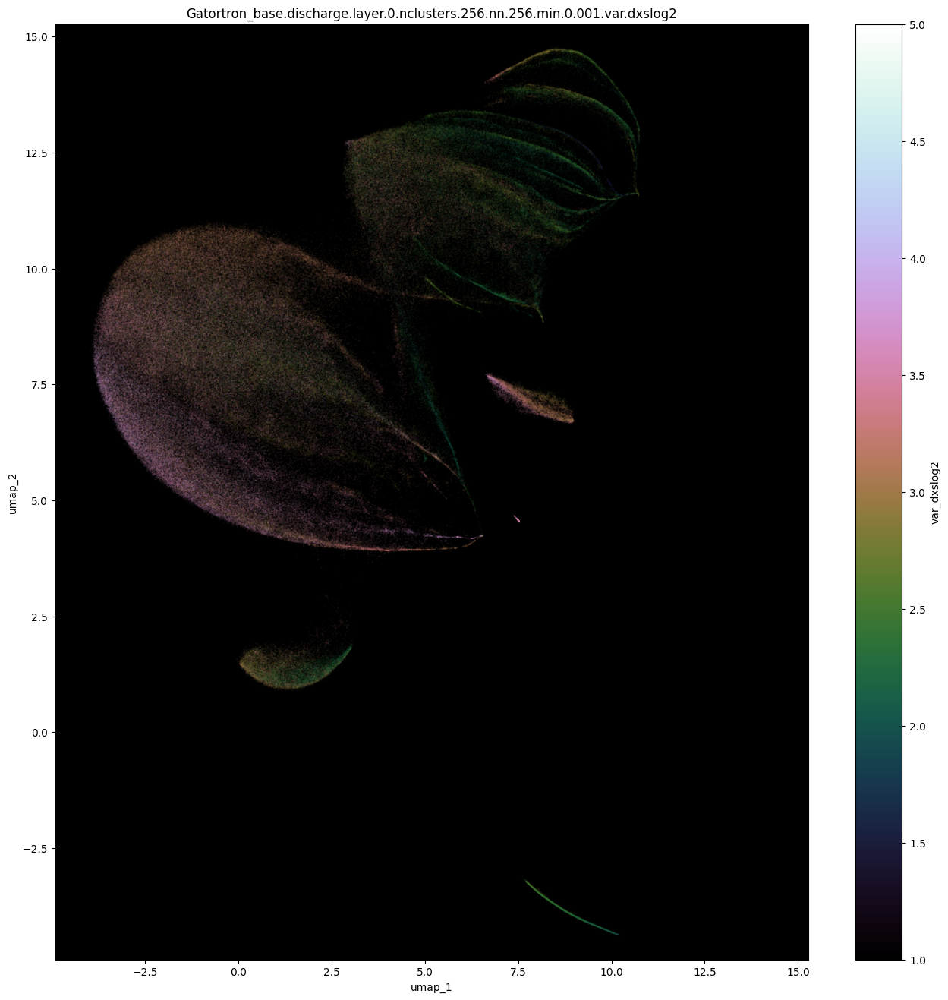

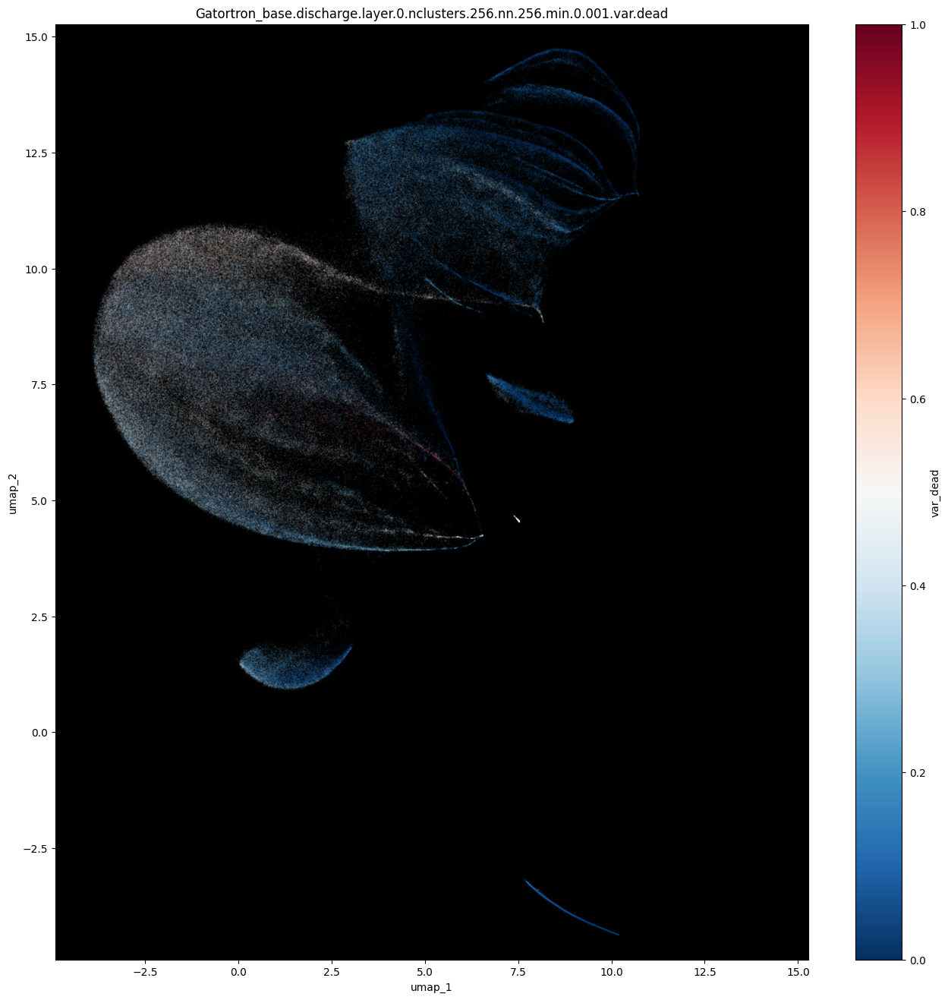

...

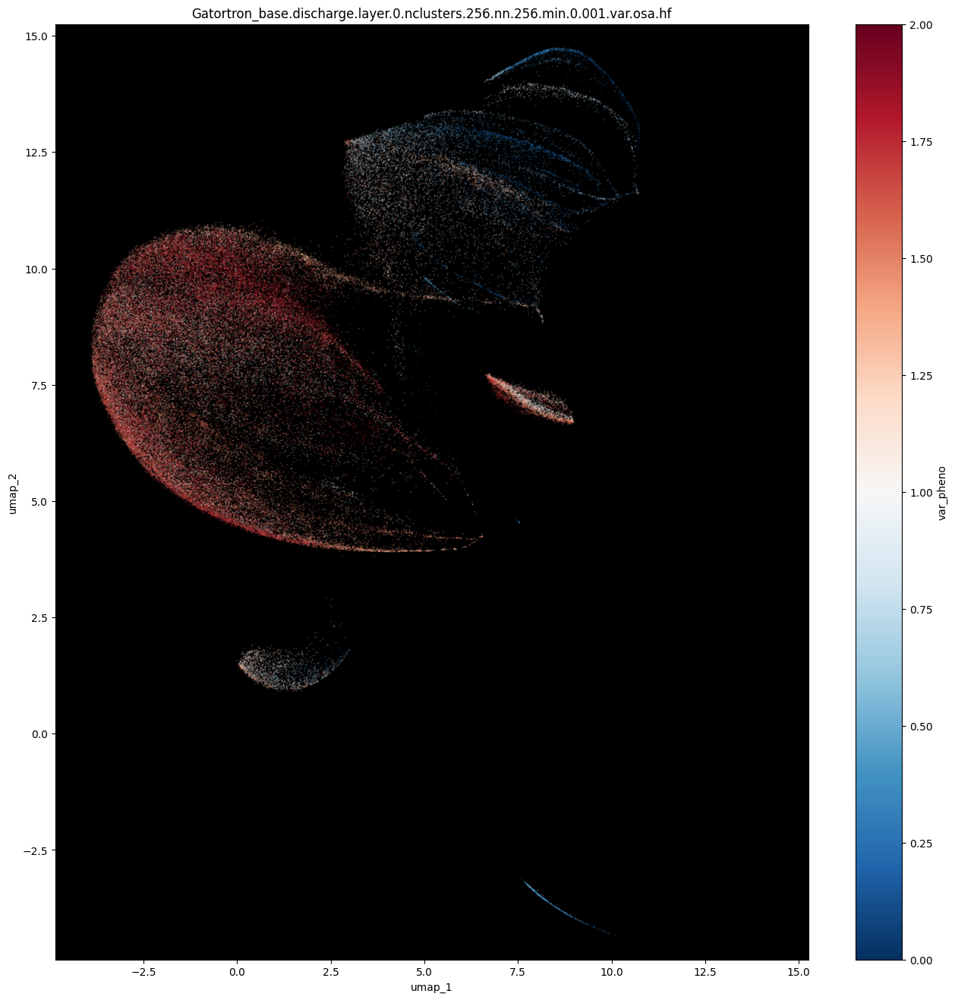

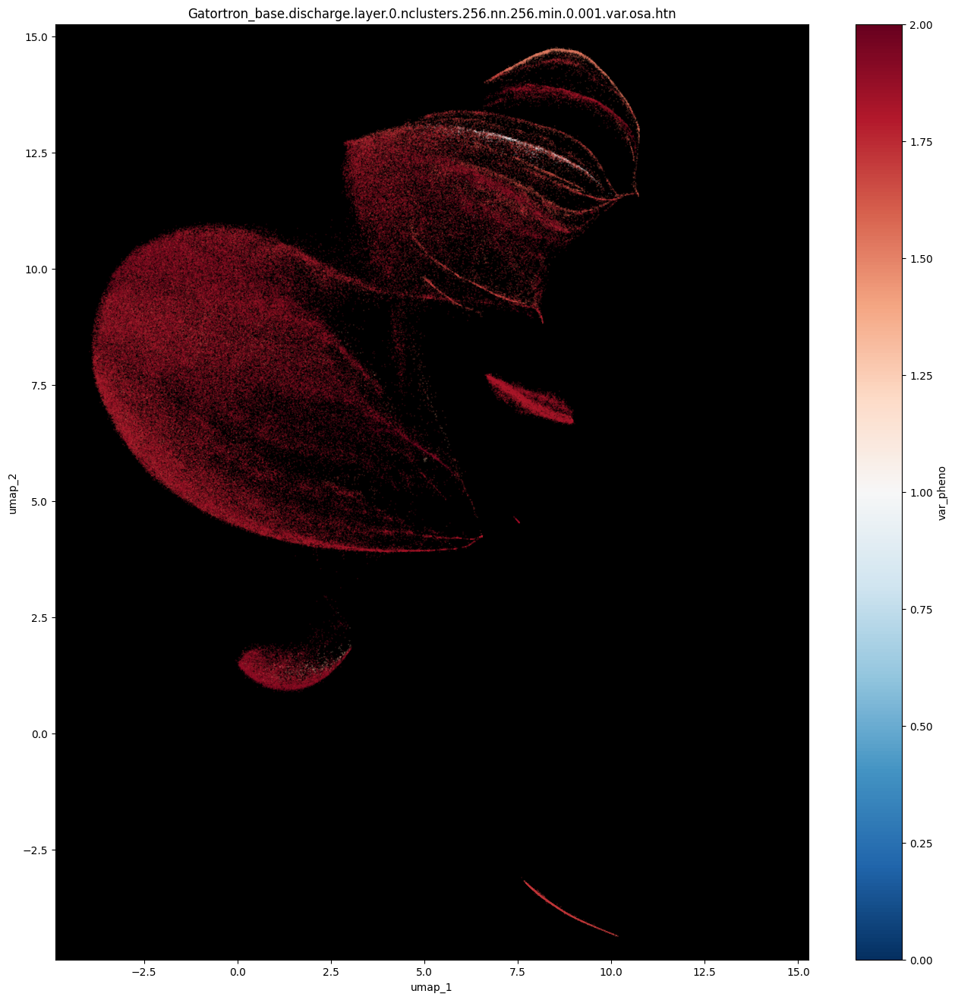

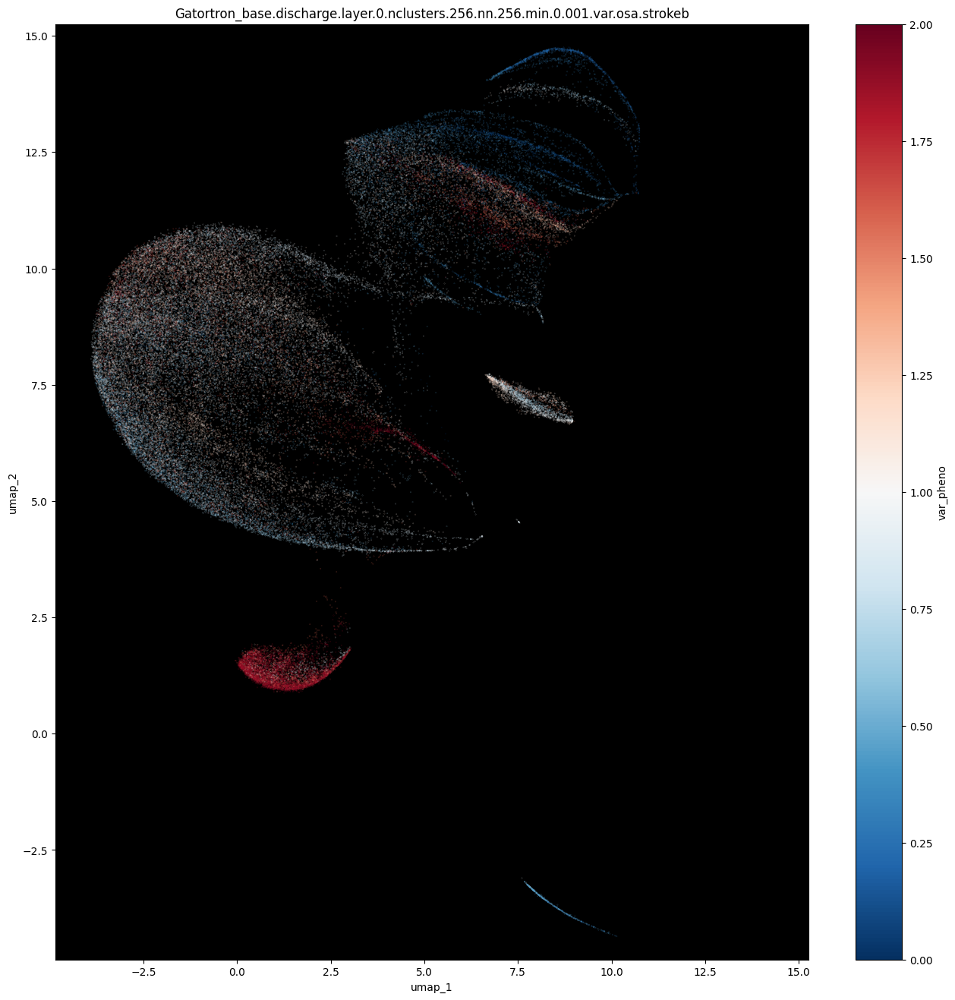

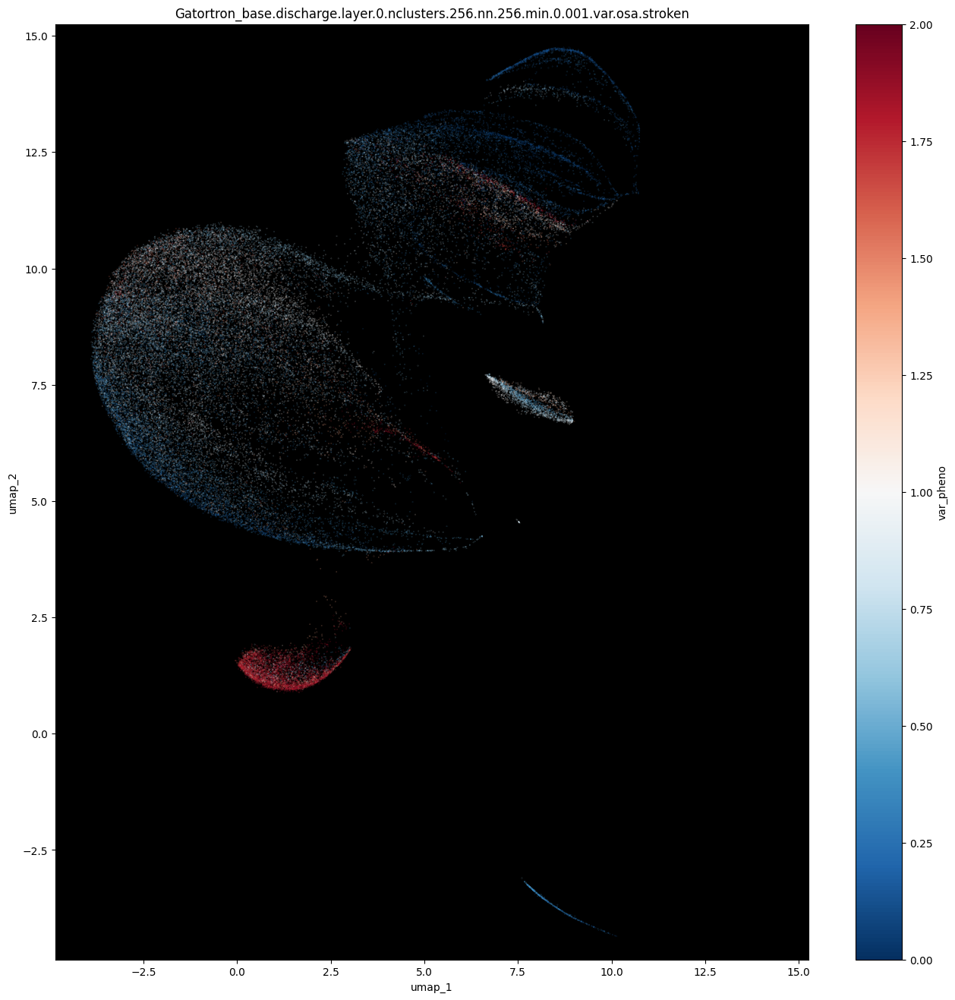

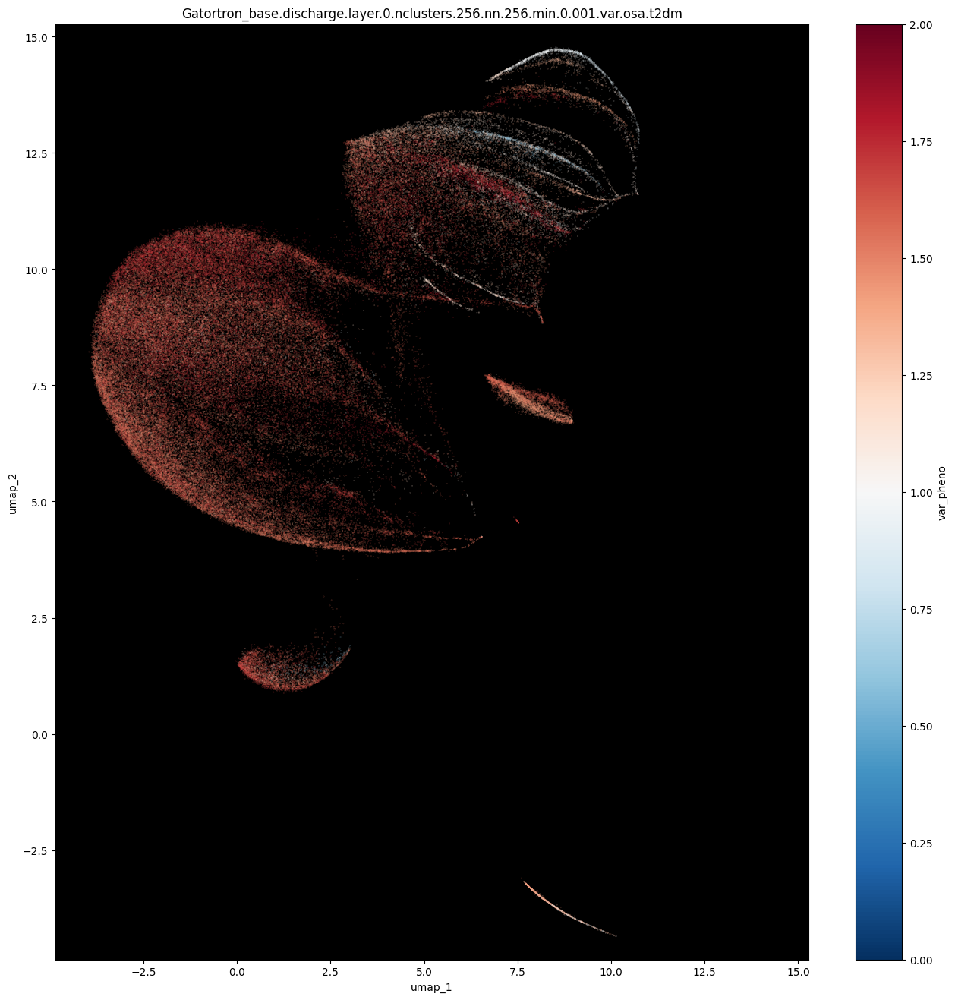

In [2]:
#- Model Config 
model = "Gatortron_base"
layer = 0
nb_clusters = 256
variables = [c.split("_")[-1] for c in df.columns[4:]]

#-
imgs = [UMAPPATH.format(model, layer, nb_clusters, v) for v in variables]
for ima in imgs: display_image(ima)

### Render Umap Plots Per Variables

In [ ]:
#-
variable = "dead"

#- 
imgs = []
df = df.sort_values("entropy_{}".format(variable)).reset_index(drop=True)
for i, row in df[["model", "layer", "nb_clusters", "entropy_{}".format(variable)]].iterrows():
    model, layer, nb_clusters, e = row
    imgs.append(UMAPPATH.format(model, layer, nb_clusters, variable))
for ima in imgs: display_image(ima)

### Render UMAP plot matrix

In [ ]:
#- 
variables = [c.split("_")[-1] for c in df.columns[4:]]
df = df.sort_values("overall_rank").reset_index(drop=True)
for i, row in df[["model", "layer", "nb_clusters"]].iterrows():
    model, layer, nb_clusters = row
    display_image_row([UMAPPATH.format(model, layer, nb_clusters, v) for v in variables])

### Comparing the Best Overall and Worst Overall

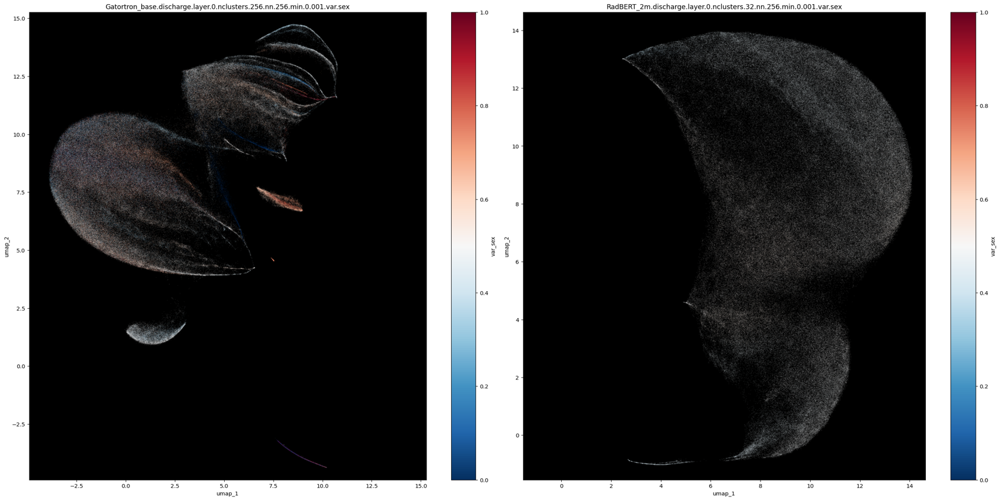

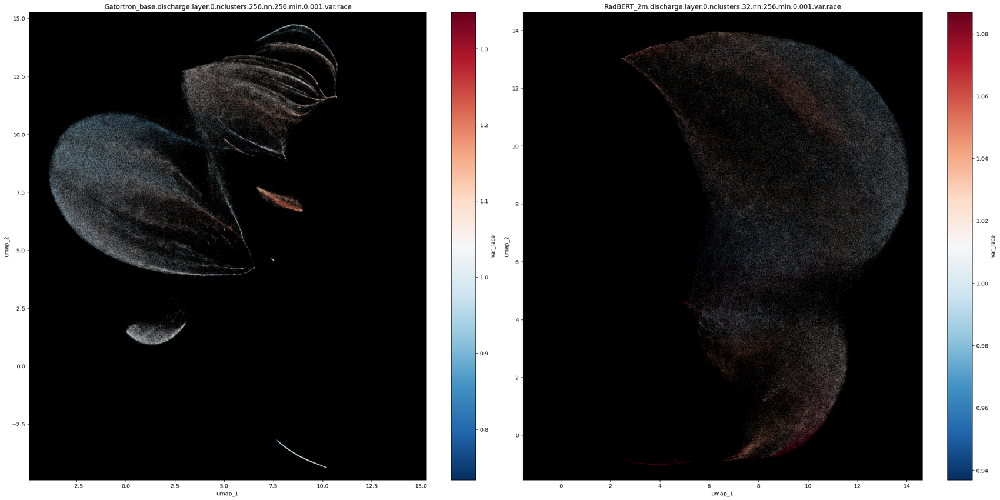

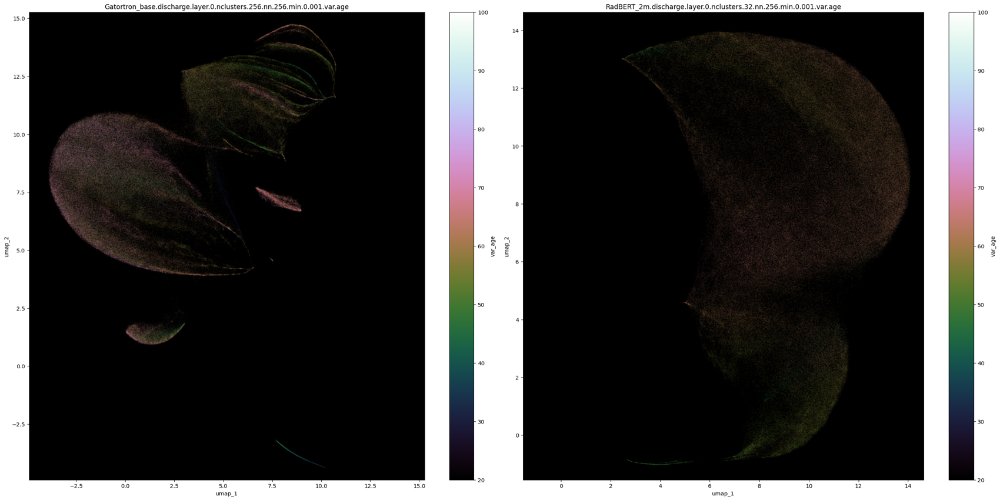

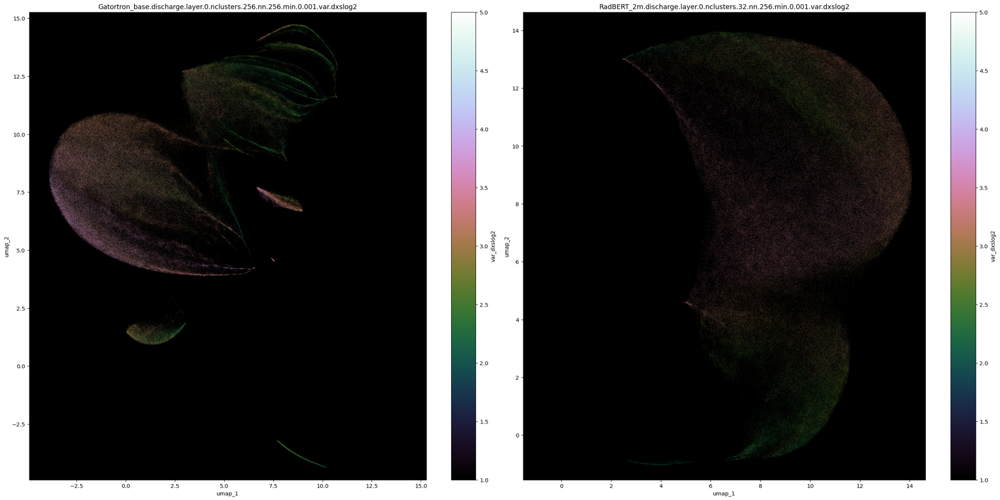

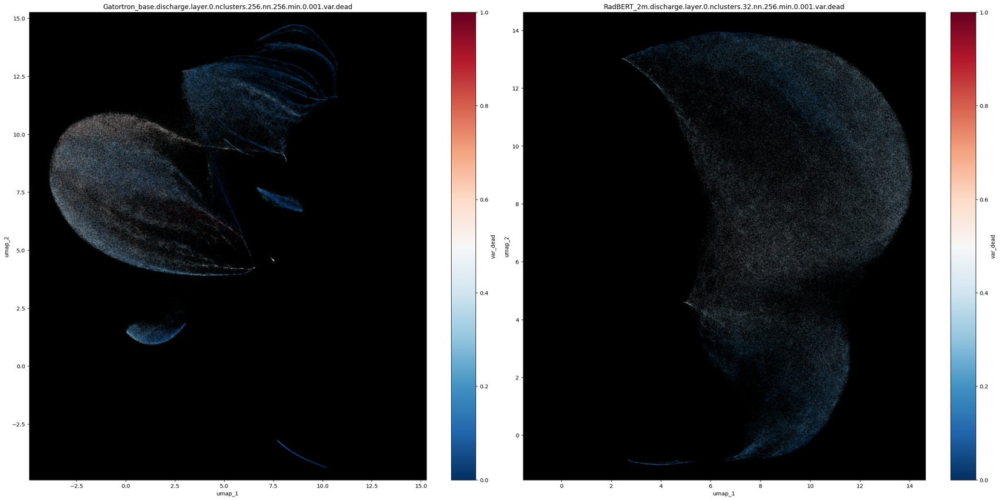

...

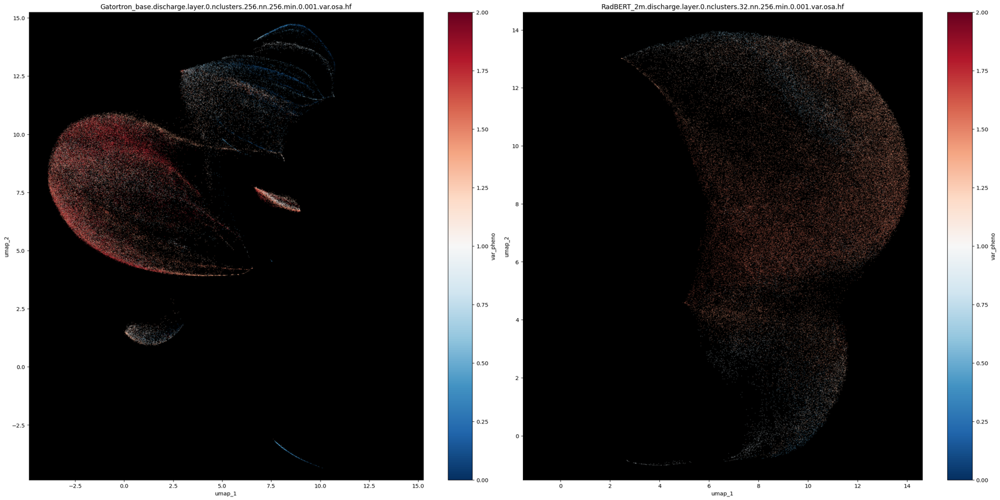

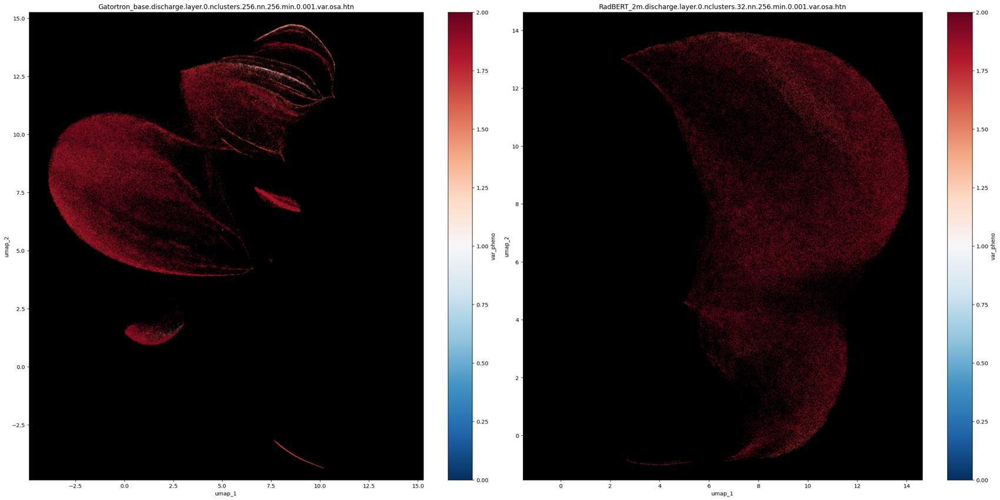

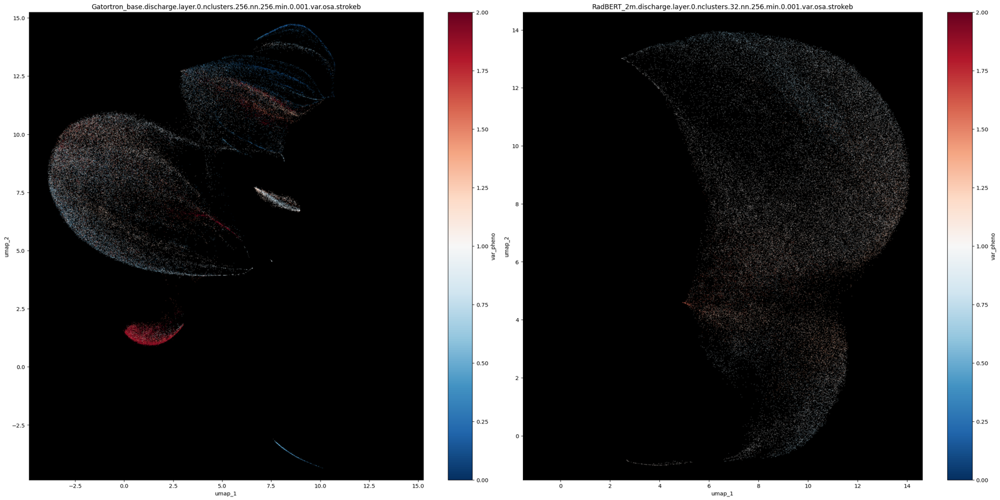

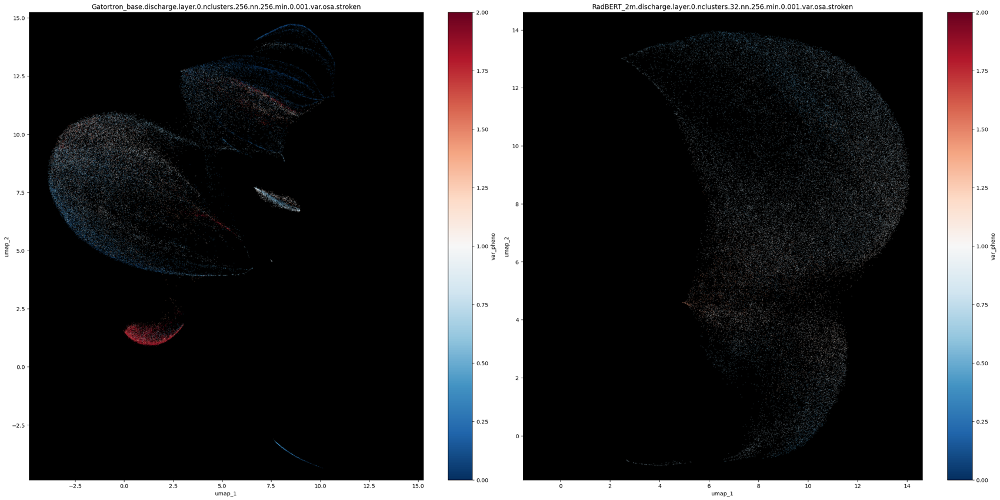

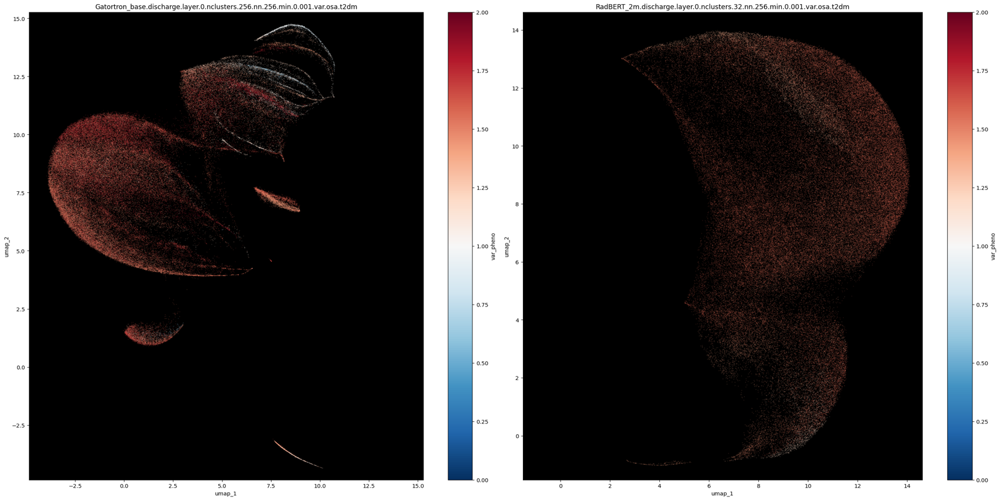

In [3]:
#- 
variables = [c.split("_")[-1] for c in df.columns[4:]]
df = df.sort_values("overall_rank").reset_index(drop=True)
best = df.loc[0][["model", "layer", "nb_clusters"]]
worst = df.loc[len(df)-1][["model", "layer", "nb_clusters"]]
for v in variables:
    bmodel, blayer, bnb_clusters = best
    wmodel, wlayer, wnb_clusters = worst
    display_image_row([UMAPPATH.format(bmodel, blayer, bnb_clusters, v),UMAPPATH.format(wmodel, wlayer, wnb_clusters, v)], width=850, height=850)